# 1. Set up the notebook

Do imports.

In [235]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from IPython.display import Image
from ae483tools import *

Find the mass $m$ of the drone in kilograms.

# 2. Estimate the mass

In [236]:
m = 34.4 / 1000 

Find a worst-case bound $\Delta m$ on the uncertainty of your estimate. This bound should be chosen so that the true mass is guaranteed to be in the interval $[m - \Delta m, m + \Delta m]$.

In [237]:
delta_m = 0.001 

# 3. Estimate the moment of inertia about the $x_B$-axis

Show a picture of your rig (change the file name or file extension as appropriate).

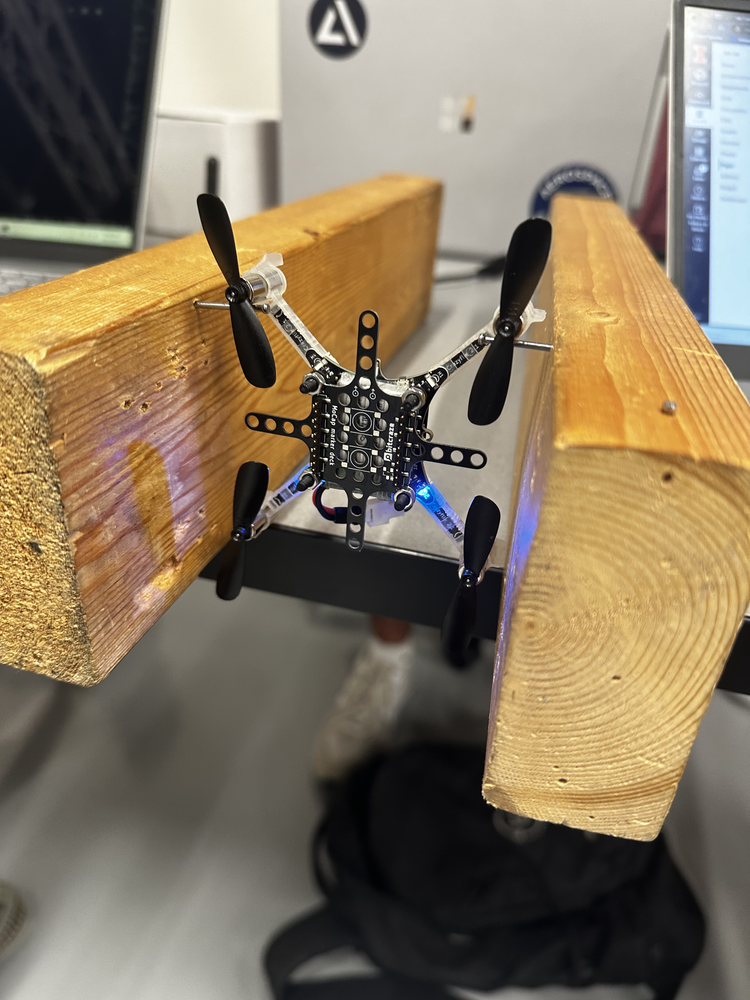

In [238]:
Image(filename='x-rig.png', width=480)

Find the distance in meters between the axis of rotation and the center of mass.

In [239]:
r = 3 / 100 # [m]

Find a worst-case bound $\Delta r$ on the uncertainty of your estimate.

In [240]:
delta_r = 1e-3 # [m]

Load, resample, and parse data to get time and the three components of angular velocity (in radians / second).

Remember that `resample_drone_data` has two optional arguments that allow you to discard data at the start and end of the experiment. You may find these arguments useful, since you will likely find that some of the data at the start and end of your experiment are garbage.

In [241]:
# Load data
raw_data_drone, raw_data_mocap = load_hardware_data('y_data.json') # Naming convention is switched, y_data.json is actually x_data

# Resample data
data_drone = resample_data_drone(
    raw_data_drone,
    t_min_offset=0.02,    
    t_max_offset=0.02,    
)

# Parse data
t = data_drone['time']
w_x = np.deg2rad(data_drone['gyro.x'])
w_y = np.deg2rad(data_drone['gyro.y'])
w_z = np.deg2rad(data_drone['gyro.z'])

Plot all three components of angular velocity. You are trying to estimate the moment of inertia about the $x$ axis. The component of angular velocity about this axis should be large, and the components of angular velocity about the other two axes should be negligibly small. It is important to check this. (Please also check if you have data at the start and end of the experiment that need to be discarded.)

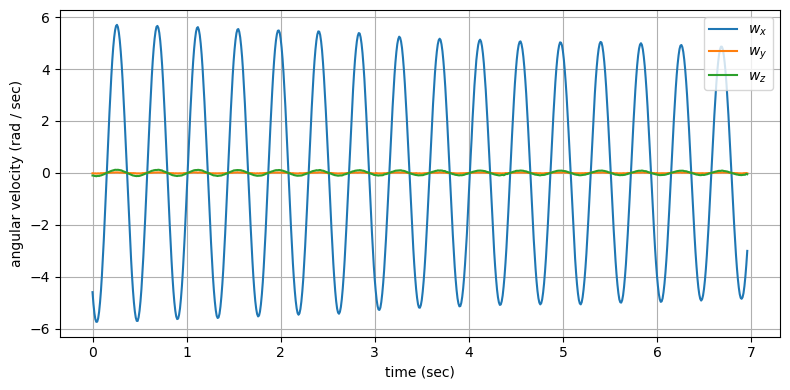

In [242]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_x, label='$w_x$')
ax.plot(t, w_y, label='$w_y$')
ax.plot(t, w_z, label='$w_z$')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

You should find that `w_x` is oscillatory. The period is the peak-to-peak time. You could measure the period by hand, but it is easier to automate this process, particularly if you want to average your estimate of the period over many oscillations.

Here is one way to do it:

* Find the index $i_k$ of each peak $k\in\{0, \dotsc, n-1\}$ in your data.
* Find the time $t_k$ at each peak for $k\in\{0, \dotsc, n-1\}$.
* Find the difference $T_k = t_{k+1} - t_k$ between consecutive peak times for $k \in \{0, \dotsc, n-2\}$.
* Find the mean difference: $$\widehat{T} = \dfrac{1}{n-1} \sum_{k=0}^{n-2} T_k.$$ This is an estimate of the oscillation period.

Here is one way to implement this in code, using [scipy.signal.find_peaks](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.find_peaks.html):

In [243]:
# Find the index of each peak (increase "prominence" if you get bad results)
peaks = find_peaks(w_x, prominence=0)
i_peaks = peaks[0]

# Find the time at each peak
t_peaks = t[i_peaks]

# Find w_x at each peak (for visualization)
w_x_peaks = w_x[i_peaks]

# Find the difference between consecutive peak times
#
# Note:
#
#  t_peaks[1:] means t_peaks without the first element
#  t_peaks[:-1] means t_peaks without the last element
#
# So, t_peaks[1:] - t_peaks[:-1] produces the following array:
#
#  [t_peaks[1]-t_peaks[0], t_peaks[0]-t_peaks[1], ...]
#
t_diff = t_peaks[1:] - t_peaks[:-1]

# Find the mean difference as an estimate of the oscillation period
T = np.mean(t_diff)

# Print the estimate
print(f'T = {T:.4f} sec')
for i in t_diff:

    print(f'T_diff = {i:.4f}sec')

T = 0.4280 sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4200sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4200sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4200sec


Sanity check — plot the peaks. (**FIXME: How do you know these results are good?**)

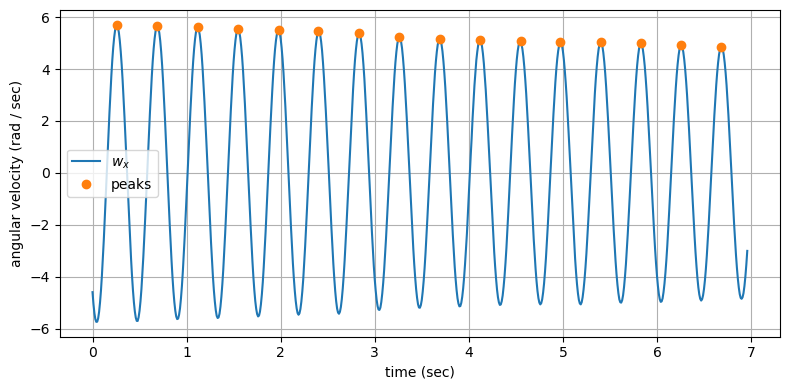

In [244]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_x, label='$w_x$')
ax.plot(t_peaks, w_x_peaks, '.', markersize=12, label='peaks')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

Sanity check — plot the differences between consecutive peak times. (**FIXME: How do you know these results are good?**)

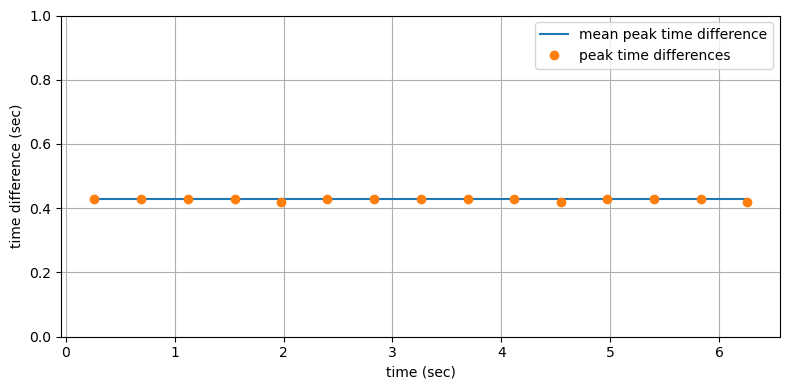

In [245]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t_peaks[:-1], T * np.ones_like(t_peaks[:-1]), label='mean peak time difference')
ax.plot(t_peaks[:-1], t_diff, '.', markersize=12, label='peak time differences')
ax.set_ylim(0., 1.)
ax.set_xlabel('time (sec)')
ax.set_ylabel('time difference (sec)')
ax.grid()
ax.legend()
plt.show()

Find a worst-case bound $\Delta T$ on the uncertainty of your estimate.

In [246]:
delta_T = max(t_diff) 
delta_T

0.4300000000000006

Find the moment of inertia about the $x$ axis.

In [247]:
g = 9.81
J_x = ((T**2)*m*g*r)/(4*np.pi**2) - (m*r**2) 

Find a worst-case bound $\Delta J_x$ on the uncertainty in your estimate.

In [248]:
delta_J_x = np.abs( ((T**2*g*r)/(4*np.pi**2) - r**2)*delta_m ) + \
            np.abs( ((T**2*m*g)/(4*np.pi**2) - 2*r*m)*delta_r ) + \
            np.abs( ((2*T*g*r*m)/(4*np.pi**2))*delta_T )

# 4. Estimate the moment of inertia about the $y_B$-axis

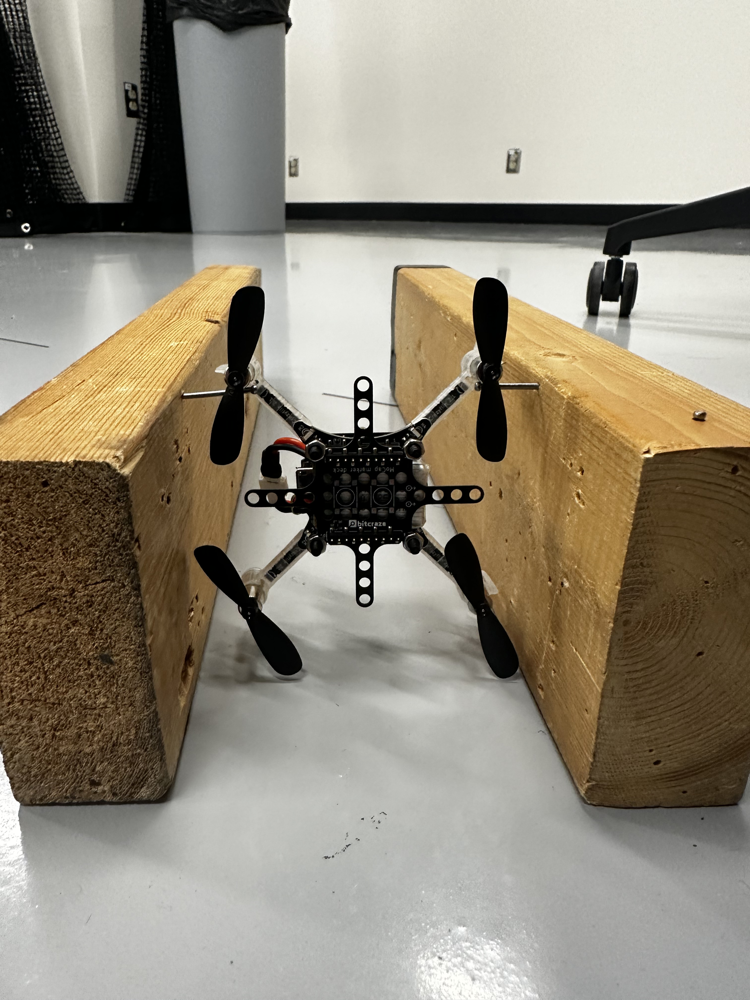

In [249]:
Image(filename='y-rig.png', width=480)

In [250]:
# Load data
raw_data_drone, raw_data_mocap = load_hardware_data('x_data.json') # Naming convention is switched, x_data.json is actually y_data

# Resample data
data_drone = resample_data_drone(
    raw_data_drone,
    t_min_offset=0.02,    
    t_max_offset=0.02,    
)

# Parse data
t = data_drone['time']
w_x = np.deg2rad(data_drone['gyro.x'])
w_y = np.deg2rad(data_drone['gyro.y'])
w_z = np.deg2rad(data_drone['gyro.z'])

Plot all three components of angular velocity. You are trying to estimate the moment of inertia about the $x$ axis. The component of angular velocity about this axis should be large, and the components of angular velocity about the other two axes should be negligibly small. It is important to check this. (Please also check if you have data at the start and end of the experiment that need to be discarded.)

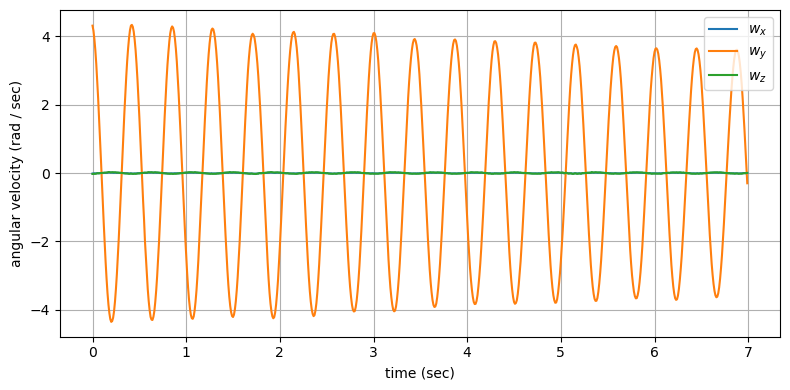

In [251]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_x, label='$w_x$')
ax.plot(t, w_y, label='$w_y$')
ax.plot(t, w_z, label='$w_z$')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

You should find that `w_x` is oscillatory. The period is the peak-to-peak time. You could measure the period by hand, but it is easier to automate this process, particularly if you want to average your estimate of the period over many oscillations.

Here is one way to do it:

* Find the index $i_k$ of each peak $k\in\{0, \dotsc, n-1\}$ in your data.
* Find the time $t_k$ at each peak for $k\in\{0, \dotsc, n-1\}$.
* Find the difference $T_k = t_{k+1} - t_k$ between consecutive peak times for $k \in \{0, \dotsc, n-2\}$.
* Find the mean difference: $$\widehat{T} = \dfrac{1}{n-1} \sum_{k=0}^{n-2} T_k.$$ This is an estimate of the oscillation period.

Here is one way to implement this in code, using [scipy.signal.find_peaks](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.find_peaks.html):

In [252]:
# Find the index of each peak (increase "prominence" if you get bad results)
peaks = find_peaks(w_y, prominence=0)
i_peaks = peaks[0]

# Find the time at each peak
t_peaks = t[i_peaks]

# Find w_x at each peak (for visualization)
w_y_peaks = w_y[i_peaks]

# Find the difference between consecutive peak times
#
# Note:
#
#  t_peaks[1:] means t_peaks without the first element
#  t_peaks[:-1] means t_peaks without the last element
#
# So, t_peaks[1:] - t_peaks[:-1] produces the following array:
#
#  [t_peaks[1]-t_peaks[0], t_peaks[0]-t_peaks[1], ...]
#
t_diff = t_peaks[1:] - t_peaks[:-1]

# Find the mean difference as an estimate of the oscillation period
T = np.mean(t_diff)

# Print the estimate
print(f'T = {T:.4f} sec')
for i in t_diff:

    print(f'T_diff = {i:.4f}sec')

T = 0.4307 sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4400sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec
T_diff = 0.4300sec


Sanity check — plot the peaks. (**FIXME: How do you know these results are good?**)

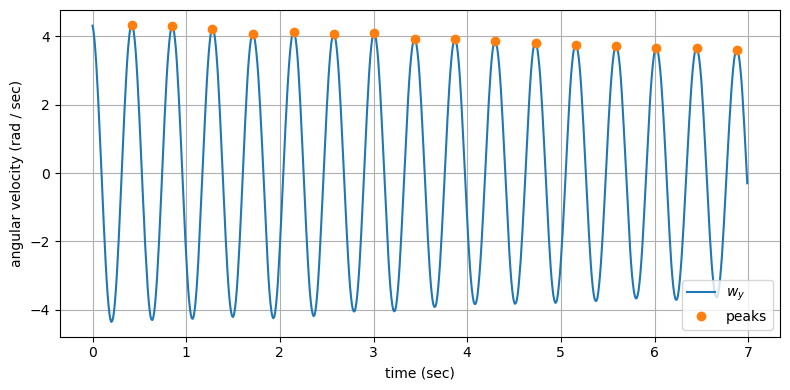

In [253]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_y, label='$w_y$')
ax.plot(t_peaks, w_y_peaks, '.', markersize=12, label='peaks')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

Sanity check — plot the differences between consecutive peak times. (**FIXME: How do you know these results are good?**)

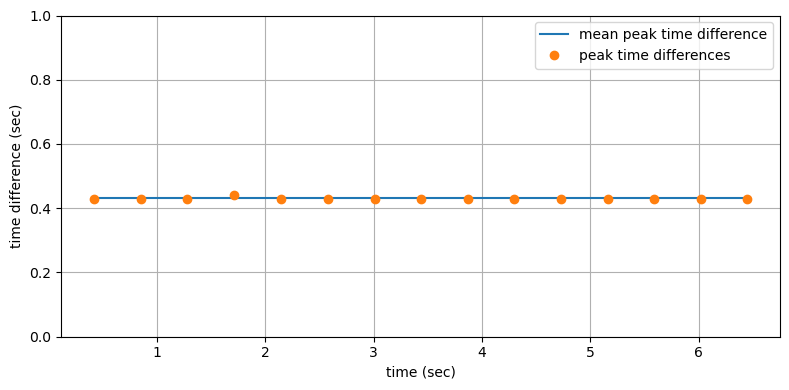

In [254]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t_peaks[:-1], T * np.ones_like(t_peaks[:-1]), label='mean peak time difference')
ax.plot(t_peaks[:-1], t_diff, '.', markersize=12, label='peak time differences')
ax.set_ylim(0., 1.)
ax.set_xlabel('time (sec)')
ax.set_ylabel('time difference (sec)')
ax.grid()
ax.legend()
plt.show()

Find a worst-case bound $\Delta T$ on the uncertainty of your estimate.

In [255]:
delta_T = max(t_diff) 
delta_T

0.43999999999999995

Find the moment of inertia about the $y$ axis.

Find a worst-case bound $\Delta J_y$ on the uncertainty in your estimate.

In [256]:
J_y = ((T**2)*m*g*r)/(4*np.pi**2) - (m*r**2)         
delta_J_y = np.abs( ((T**2*g*r)/(4*np.pi**2) - r**2)*delta_m ) + \
            np.abs( ((T**2*m*g)/(4*np.pi**2) - 2*r*m)*delta_r ) + \
            np.abs( ((2*T*g*r*m)/(4*np.pi**2))*delta_T )    

# 5. Estimate the moment of inertia about the $z_B$-axis

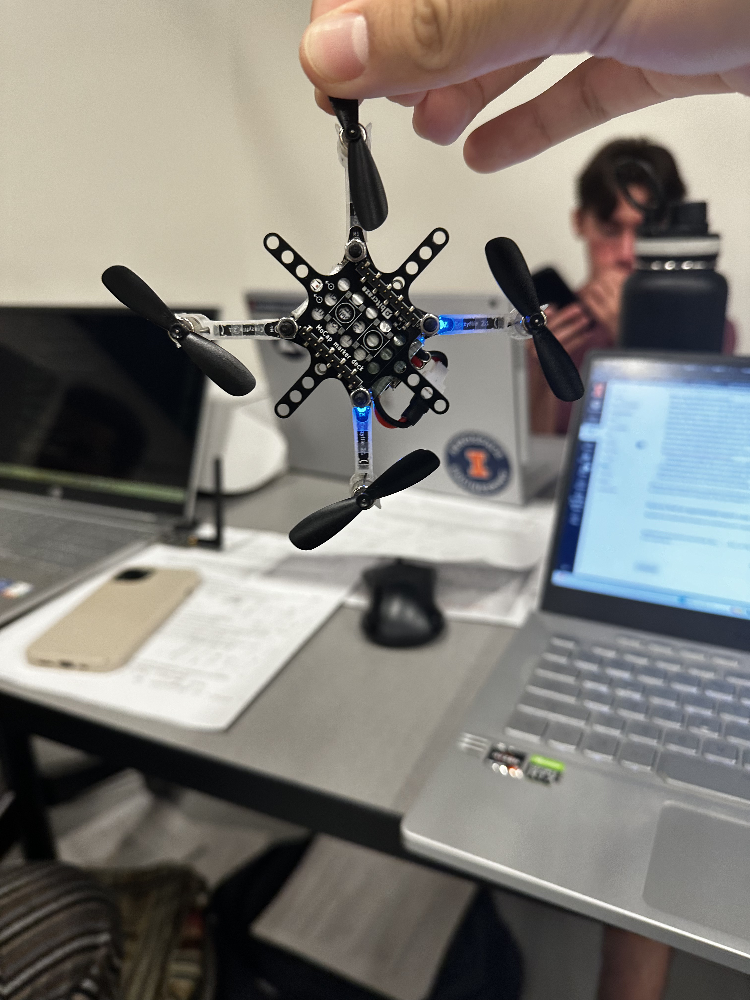

In [257]:
Image(filename='z-rig.png', width=480)

In [258]:
# Load data
raw_data_drone, raw_data_mocap = load_hardware_data('z_data.json')

# Resample data
data_drone = resample_data_drone(
    raw_data_drone,
    t_min_offset=0.02,   
    t_max_offset=2.0,    
)

# Parse data
t = data_drone['time']
w_x = np.deg2rad(data_drone['gyro.x'])
w_y = np.deg2rad(data_drone['gyro.y'])
w_z = np.deg2rad(data_drone['gyro.z'])

Plot all three components of angular velocity. You are trying to estimate the moment of inertia about the $x$ axis. The component of angular velocity about this axis should be large, and the components of angular velocity about the other two axes should be negligibly small. It is important to check this. (Please also check if you have data at the start and end of the experiment that need to be discarded.)

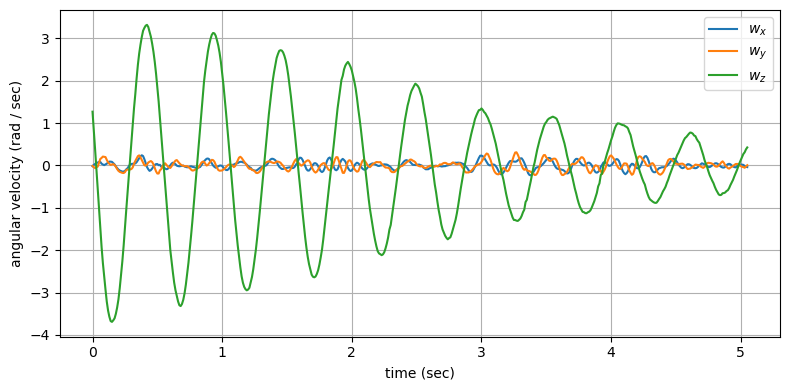

In [259]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_x, label='$w_x$')
ax.plot(t, w_y, label='$w_y$')
ax.plot(t, w_z, label='$w_z$')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

You should find that `w_x` is oscillatory. The period is the peak-to-peak time. You could measure the period by hand, but it is easier to automate this process, particularly if you want to average your estimate of the period over many oscillations.

Here is one way to do it:

* Find the index $i_k$ of each peak $k\in\{0, \dotsc, n-1\}$ in your data.
* Find the time $t_k$ at each peak for $k\in\{0, \dotsc, n-1\}$.
* Find the difference $T_k = t_{k+1} - t_k$ between consecutive peak times for $k \in \{0, \dotsc, n-2\}$.
* Find the mean difference: $$\widehat{T} = \dfrac{1}{n-1} \sum_{k=0}^{n-2} T_k.$$ This is an estimate of the oscillation period.

Here is one way to implement this in code, using [scipy.signal.find_peaks](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.find_peaks.html):

In [260]:
# Find the index of each peak (increase "prominence" if you get bad results)
peaks = find_peaks(w_z, prominence=0)
i_peaks = peaks[0]

# Find the time at each peak
t_peaks = t[i_peaks]

# Find w_x at each peak (for visualization)
w_z_peaks = w_z[i_peaks]

# Find the difference between consecutive peak times
#
# Note:
#
#  t_peaks[1:] means t_peaks without the first element
#  t_peaks[:-1] means t_peaks without the last element
#
# So, t_peaks[1:] - t_peaks[:-1] produces the following array:
#
#  [t_peaks[1]-t_peaks[0], t_peaks[0]-t_peaks[1], ...]
#
t_diff = t_peaks[1:] - t_peaks[:-1]

# Find the mean difference as an estimate of the oscillation period
T = np.mean(t_diff)

# Print the estimate
print(f'T = {T:.4f} sec')
for i in t_diff:

    print(f'T_diff = {i:.4f}sec')

T = 0.5238 sec
T_diff = 0.5100sec
T_diff = 0.5200sec
T_diff = 0.5200sec
T_diff = 0.5200sec
T_diff = 0.5100sec
T_diff = 0.5500sec
T_diff = 0.5000sec
T_diff = 0.5600sec


Sanity check — plot the peaks. (**FIXME: How do you know these results are good?**)

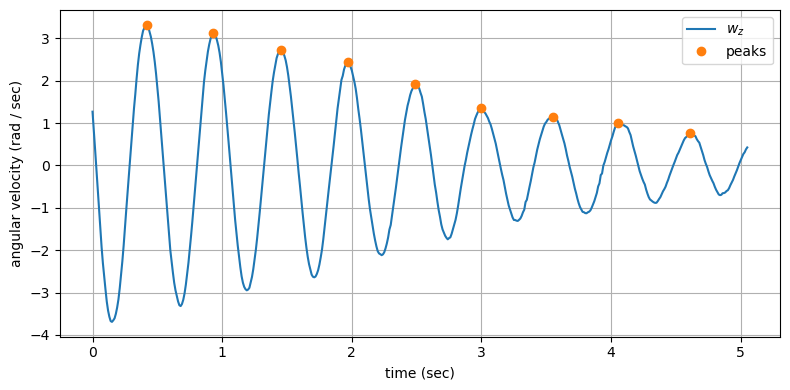

In [261]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t, w_z, label='$w_z$')
ax.plot(t_peaks, w_z_peaks, '.', markersize=12, label='peaks')
ax.set_xlabel('time (sec)')
ax.set_ylabel('angular velocity (rad / sec)')
ax.legend()
ax.grid()
plt.show()

Sanity check — plot the differences between consecutive peak times. (**FIXME: How do you know these results are good?**)

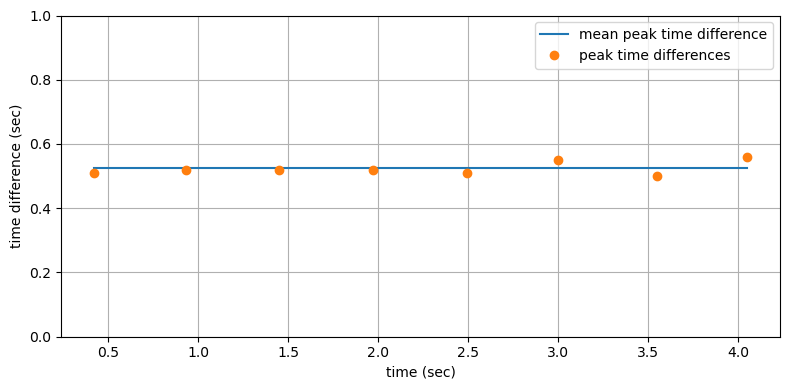

In [262]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4), tight_layout=True)
ax.plot(t_peaks[:-1], T * np.ones_like(t_peaks[:-1]), label='mean peak time difference')
ax.plot(t_peaks[:-1], t_diff, '.', markersize=12, label='peak time differences')
ax.set_ylim(0., 1.)
ax.set_xlabel('time (sec)')
ax.set_ylabel('time difference (sec)')
ax.grid()
ax.legend()
plt.show()

Find a worst-case bound $\Delta T$ on the uncertainty of your estimate.

In [263]:
delta_T = max(t_diff) 
delta_T

0.5600000000000005

Find the moment of inertia about the $z$ axis.

Find a worst-case bound $\Delta J_z$ on the uncertainty in your estimate.

In [264]:
r_z = 6.5e-2
g = 9.81
J_z = ((T**2)*m*g*r)/(4*np.pi**2) - (m*r**2)        
delta_J_z = np.abs( ((T**2*g*r_z)/(4*np.pi**2) - r_z**2)*delta_m ) + \
            np.abs( ((T**2*m*g)/(4*np.pi**2) - 2*r_z*m)*delta_r ) + \
            np.abs( ((2*T*g*r_z*m)/(4*np.pi**2))*delta_T )    

# 6. Summarize and discuss the results

### Summary of results

In [265]:
print(f'm = {m:.4f} +/- {delta_m:.4f} kg')
print(f'J_x = {J_x:.2e} +/- {delta_J_x:.2e} kg m^2')
print(f'J_y = {J_y:.2e} +/- {delta_J_y:.2e} kg m^2')
print(f'J_z = {J_z:.2e} +/- {delta_J_z:.2e} kg m^2')

print(delta_m)
print(delta_r)
print(delta_T)

m = 0.0344 +/- 0.0010 kg
J_x = 1.60e-05 +/- 9.54e-05 kg m^2
J_y = 1.66e-05 +/- 9.81e-05 kg m^2
J_z = 3.94e-05 +/- 3.28e-04 kg m^2
0.001
0.001
0.5600000000000005


### Analysis of uncertainty

**Modify the text in this cell** to answer the following questions:
Which computed quantities ($J_x$, $J_y$, $J_z$) are the most uncertain?
* The moment of inertia about the z axis is the most uncertain because it has the largest worst-case bound delta_J.
 
Which measured quantities ($m$, $r$, $T$) contribute the most to uncertainty in the computed quantities?
* The measured time contributes the most because it's delta T has a greater order of magnitude than r and m, being 1e-1 vs 1e-3.

What assumptions were made and to what extent were these assumptions violated?
* We worked under the assumption that no external forces acted on the drone other than gravity when we took our data. This assumption could be violated to an extent depending on if the drone accidently grazed the wood blocks when it was oscillating, thus adding a friction force. We also assumed the drone's center of mass is dead center when viewing it from a bird's eye view, which could effect the moment arm length measured.

What sources of error might not be captured in your analysis of uncertainty?
* The effects of air resistance against the drone as it oscillated could produce a small force on the drone. The drone oscillated in not unmoving setups, the first being the table which has the potential to be bumped and the second being hand held where user error can come into play. 

### Ways to improve the results

Propose at least one way in which the experiments or the analysis could be improved to get estimates of mass and moments of inertia that are more accurate (i.e., less uncertain). You could suggest improvements to your current method of approach, but you are also welcome to suggest a completely different method of approach.

* One way to improve the experiment would be to identify the actual center of mass of the drone and consider the length from that location to the z-axis to be the moment arm length. Using a scale with more accuracy to reduce the uncertainty in the mass measured and conducting the experiment in a vaccuum chamber to negate the effects of air resistance are two additional improvements.  